Estimado candidato,

Estamos encantados de que estés considerando unirte a nuestro equipo de ciencia de datos. Como parte de nuestro proceso de evaluación, te pedimos que completes la siguiente prueba técnica.

**Descripción de la tarea:**

Se te proporciona un conjunto de datos anónimos que consta de varias columnas nombradas como 'col1', 'col2', 'col3', etc., hasta 'col20', y una columna 'target' que representa la variable objetivo. Tu tarea es realizar un análisis exploratorio de datos (EDA) y construir un modelo de aprendizaje automático para predecir la variable 'target'.

**Detalles de la tarea:**

1. **Análisis exploratorio de datos (EDA):** Realiza un análisis exploratorio detallado de los datos. Esto debe incluir, pero no está limitado a:
   - Estadísticas descriptivas de las variables (mínimo, máximo, media, mediana, desviación estándar, etc.).
   - Verificación de valores perdidos o anómalos.
   - Análisis de correlación entre las variables.
   - Visualizaciones para entender mejor las distribuciones y relaciones de los datos.

2. **Preprocesamiento de datos:** Prepárate para realizar cualquier limpieza o transformación necesaria de los datos basándote en tu EDA.

3. **Creación de un modelo de línea base (Baseline):** Entrena varios modelos de aprendizaje automático para predecir la variable 'target'. Comienza con modelos sencillos como la regresión logística y avanza hacia modelos más complejos como los árboles de decisión, random forest, SVM, XGBoost, etc.

4. **Evaluación del modelo:** Evalúa el rendimiento de cada modelo utilizando métricas apropiadas. Por ejemplo, si 'target' es una variable binaria, podrías considerar la precisión, la sensibilidad, la especificidad, el AUC-ROC, etc.

5. **Selección del modelo:** Selecciona el modelo que creas que funciona mejor. Justifica tu elección basándote en las métricas de evaluación y cualquier otra consideración pertinente.

6. **Predicción:** Usa tu modelo seleccionado para hacer predicciones en el conjunto de datos.

**Entregables:**

Por favor, proporciona el código que hayas utilizado para completar esta tarea, junto con un informe detallado que explique tu enfoque y los resultados. El informe debe estar bien estructurado y ser fácil de seguir, permitiendo a los evaluadores entender tu proceso de pensamiento y las decisiones que hayas tomado.

¡Buena suerte y esperamos ver tu solución!

Empezamos instalando e importando las librerías que vamos a utilizar. 

In [2]:
# Tratamiento de datos
# ==============================================================================
import pandas as pd
import numpy as np

# Gráficos
# ==============================================================================
import matplotlib.pyplot as plt
from matplotlib import style
import seaborn as sns

# Preprocesado y modelado
# ==============================================================================
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.stats.weightstats import ttest_ind
from scipy.stats import ttest_ind

# Configuración matplotlib
# ==============================================================================
plt.rcParams['image.cmap'] = "bwr"
#plt.rcParams['figure.dpi'] = "100"
plt.rcParams['savefig.bbox'] = "tight"
style.use('ggplot') or plt.style.use('ggplot')

# Configuración warnings
# ==============================================================================
import warnings
warnings.filterwarnings('ignore')

In [ ]:
#pd.set_option("display.max_rows", 500) # Cuántas filas de los DataFrames nos da pandas en el Notebook
sns.set(color_codes=True)


1.1 Limpieza de datos 

In [3]:
#df_ = pd.read_csv("Ruta_fichero")

data = pd.read_csv(r"C:\Users\mareg\OneDrive\Documentos\TheBridge_Enero\Machine_Learning\Entregas\Prueba_Tecnica_Nivel\data\train.csv")
df = data.copy()
df.head()


,ID,col1,col2,col3,col4,col5,col6,col7,col8,col9,...,col12,col13,col14,col15,col16,col17,col18,col19,col20,target
0,4995,0.02,26.80,0.09,1.35,0.060,0.09,0.09,1.97,1.48,...,0.031,9.52,0.84,0.001,1.24,0.96,0.09,0.08,0.08,0
1,1709,1.13,3.95,0.32,3.95,0.030,4.66,0.56,1.89,1.36,...,0.170,13.83,1.15,0.006,10.55,3.76,0.02,0.45,0.06,0
2,7825,0.07,8.05,0.04,0.14,0.040,0.06,0.06,0.05,0.00,...,0.120,2.61,1.52,0.008,4.13,0.27,0.03,0.03,0.01,0
3,6918,0.09,26.40,0.03,0.92,0.090,0.57,0.00,0.36,0.03,...,0.055,5.22,1.96,0.000,11.32,0.25,0.09,0.01,0.05,0
4,5,0.94,14.47,0.03,2.88,0.003,0.80,0.43,1.38,0.11,...,0.135,9.75,1.89,0.006,27.17,5.42,0.08,0.19,0.02,1


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5597 entries, 0 to 5596
Data columns (total 22 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   ID      5597 non-null   int64  
 1   col1    5597 non-null   float64
 2   col2    5597 non-null   float64
 3   col3    5597 non-null   float64
 4   col4    5597 non-null   float64
 5   col5    5597 non-null   float64
 6   col6    5597 non-null   float64
 7   col7    5597 non-null   float64
 8   col8    5597 non-null   float64
 9   col9    5597 non-null   float64
 10  col10   5597 non-null   float64
 11  col11   5597 non-null   float64
 12  col12   5597 non-null   float64
 13  col13   5597 non-null   float64
 14  col14   5597 non-null   float64
 15  col15   5597 non-null   float64
 16  col16   5597 non-null   float64
 17  col17   5597 non-null   float64
 18  col18   5597 non-null   float64
 19  col19   5597 non-null   float64
 20  col20   5597 non-null   float64
 21  target  5597 non-null   int64  
dtype

Vemos si está balanceado o no el target (desbalanceado)

In [5]:
df.target.value_counts(normalize=True)

0    0.885653
1    0.114347
Name: target, dtype: float64

In [16]:
valores_unicos = df['target'].unique()
print(valores_unicos)

[0 1]


para ver todas las columnas y los parametros estadísticos más importantes

In [13]:
df.describe(include='all')

,ID,col1,col2,col3,col4,col5,col6,col7,col8,col9,...,col12,col13,col14,col15,col16,col17,col18,col19,col20,target
count,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,...,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000,5597.000000
mean,3962.909952,0.674797,14.438840,0.163603,1.579702,0.042747,2.213093,0.250890,0.807654,0.766057,...,0.100050,9.819267,1.331880,0.005194,16.621249,2.931896,0.049602,0.149855,0.044999,0.114347
std,2311.129964,1.273677,8.851097,0.254659,1.221220,0.036072,2.581244,0.272472,0.652471,0.436435,...,0.057997,5.581795,0.568734,0.002960,17.729833,2.327347,0.028827,0.144170,0.026929,0.318261
min,0.000000,0.000000,-0.080000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.001000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1963.000000,0.040000,6.850000,0.030000,0.550000,0.008000,0.100000,0.050000,0.090000,0.400000,...,0.049000,4.940000,1.010000,0.003000,2.220000,0.820000,0.020000,0.040000,0.020000,0.000000
50%,3922.000000,0.070000,14.390000,0.050000,1.210000,0.040000,0.550000,0.090000,0.750000,0.760000,...,0.103000,9.860000,1.420000,0.005000,7.840000,2.430000,0.050000,0.080000,0.050000,0.000000
75%,5960.000000,0.290000,22.260000,0.100000,2.510000,0.070000,4.330000,0.450000,1.390000,1.160000,...,0.151000,14.690000,1.760000,0.008000,29.980000,4.670000,0.070000,0.250000,0.070000,0.000000
max,7993.000000,5.050000,29.840000,1.050000,4.940000,0.130000,8.660000,0.900000,2.000000,1.500000,...,0.200000,19.820000,2.890000,0.010000,60.010000,7.990000,0.100000,0.500000,0.090000,1.000000


Creamos una función con la información

In [14]:
def data_report(df):
    # Sacamos los NOMBRES
    cols = pd.DataFrame(df.columns.values, columns=["COL_N"])

    # Sacamos los TIPOS
    types = pd.DataFrame(df.dtypes.values, columns=["DATA_TYPE"])

    # Sacamos los MISSINGS
    percent_missing = round(df.isnull().sum() * 100 / len(df), 2)
    percent_missing_df = pd.DataFrame(percent_missing.values, columns=["MISSINGS (%)"])

    # Sacamos los VALORES UNICOS
    unicos = pd.DataFrame(df.nunique().values, columns=["UNIQUE_VALUES"])
    
    percent_cardin = round(unicos['UNIQUE_VALUES']*100/len(df), 2)
    percent_cardin_df = pd.DataFrame(percent_cardin.values, columns=["CARDIN (%)"])

    concatenado = pd.concat([cols, types, percent_missing_df, unicos, percent_cardin_df], axis=1, sort=False)
    concatenado.set_index('COL_N', drop=True, inplace=True)


    return concatenado.T
        
data_report(df)

COL_N,ID,col1,col2,col3,col4,col5,col6,col7,col8,col9,...,col12,col13,col14,col15,col16,col17,col18,col19,col20,target
DATA_TYPE,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,...,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64
MISSINGS (%),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
UNIQUE_VALUES,5597,479,2320,107,470,23,784,91,201,151,...,199,1664,274,11,2562,724,11,51,10,2
CARDIN (%),100.0,8.56,41.45,1.91,8.4,0.41,14.01,1.63,3.59,2.7,...,3.56,29.73,4.9,0.2,45.77,12.94,0.2,0.91,0.18,0.04


In [18]:
df.columns

Index(['ID', 'col1', 'col2', 'col3', 'col4', 'col5', 'col6', 'col7', 'col8',
       'col9', 'col10', 'col11', 'col12', 'col13', 'col14', 'col15', 'col16',
       'col17', 'col18', 'col19', 'col20', 'target'],
      dtype='object')

Análisis univariante

Visualizamos las columnas para ver su posible distribución

array([[<AxesSubplot:title={'center':'ID'}>,
        <AxesSubplot:title={'center':'col1'}>,
        <AxesSubplot:title={'center':'col2'}>,
        <AxesSubplot:title={'center':'col3'}>,
        <AxesSubplot:title={'center':'col4'}>],
       [<AxesSubplot:title={'center':'col5'}>,
        <AxesSubplot:title={'center':'col6'}>,
        <AxesSubplot:title={'center':'col7'}>,
        <AxesSubplot:title={'center':'col8'}>,
        <AxesSubplot:title={'center':'col9'}>],
       [<AxesSubplot:title={'center':'col10'}>,
        <AxesSubplot:title={'center':'col11'}>,
        <AxesSubplot:title={'center':'col12'}>,
        <AxesSubplot:title={'center':'col13'}>,
        <AxesSubplot:title={'center':'col14'}>],
       [<AxesSubplot:title={'center':'col15'}>,
        <AxesSubplot:title={'center':'col16'}>,
        <AxesSubplot:title={'center':'col17'}>,
        <AxesSubplot:title={'center':'col18'}>,
        <AxesSubplot:title={'center':'col19'}>],
       [<AxesSubplot:title={'center':'col20'}>, 

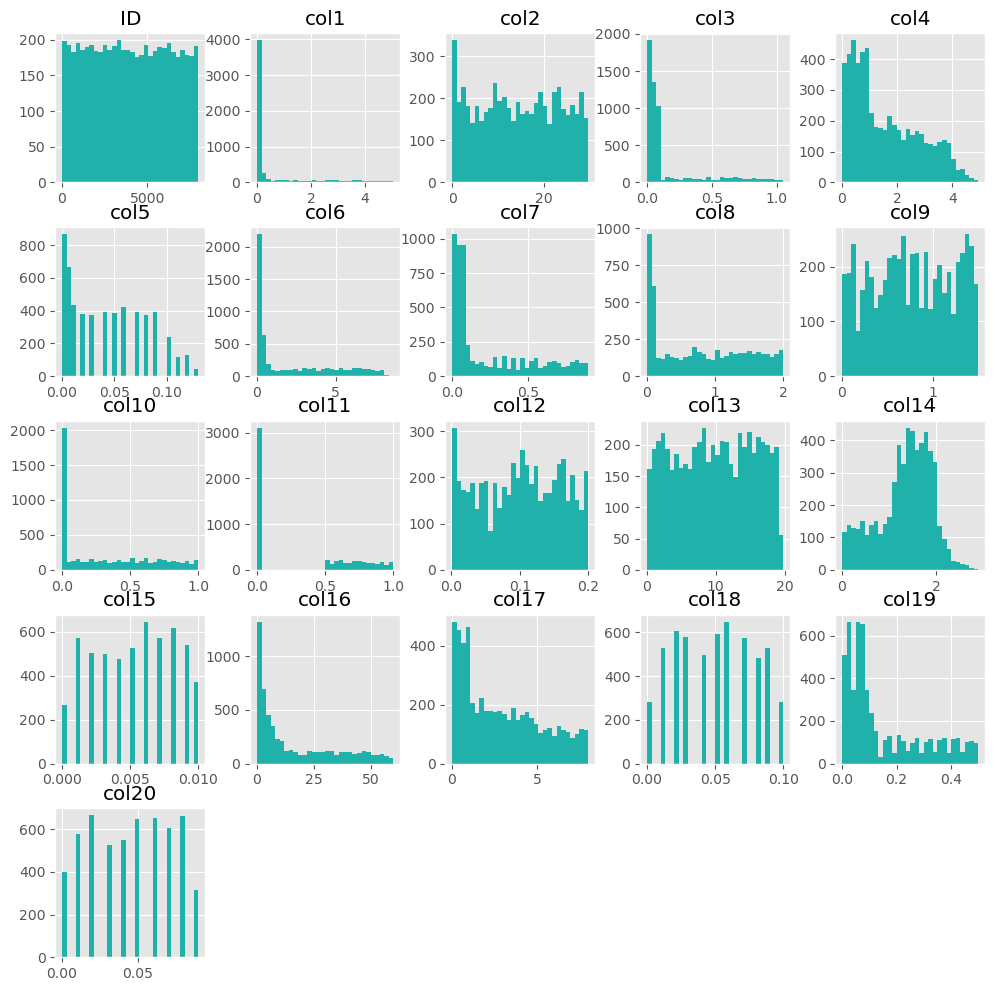

In [19]:
df[['ID', 'col1', 'col2', 'col3', 'col4', 'col5', 'col6', 'col7', 'col8',
       'col9', 'col10', 'col11', 'col12', 'col13', 'col14', 'col15', 'col16',
       'col17', 'col18', 'col19', 'col20',]].hist(bins=30, figsize = (12,12), color='lightseagreen')

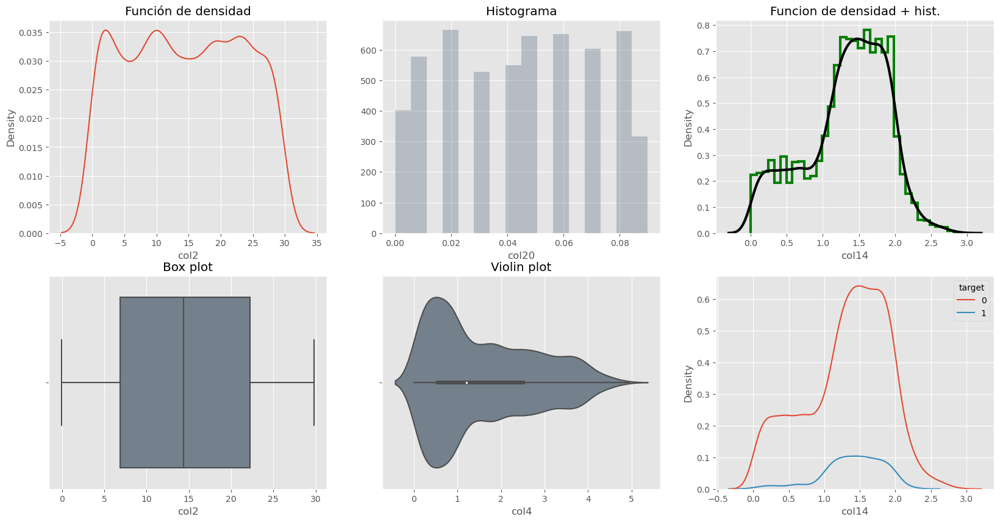

In [24]:
fig, axes = plt.subplots(2, 3, figsize=(20, 10))

# Funcion de densidad
sns.distplot(df['col2'], hist = False, ax=axes[0, 0])
axes[0, 0].set_title("Función de densidad")

# Histograma
sns.distplot(df['col20'],
             kde=False,
             color='slategray',
             ax=axes[0, 1]);

axes[0, 1].set_title("Histograma")

# Funcion de densidad + histograma
sns.distplot(df['col14'],
            kde_kws={"color": "k", "lw": 3, "label": "KDE"},
            hist_kws={"histtype": "step", "linewidth": 3,
                      "alpha": 1, "color": "g"},
             ax=axes[0, 2])


axes[0, 2].set_title("Funcion de densidad + hist.")

# Boxplot
sns.boxplot(df['col2'], color="slategray", ax=axes[1, 0])
axes[1, 0].set_title("Box plot")

# Violin plot
sns.violinplot(df['col4'], color="slategray", ax=axes[1, 1])
axes[1, 1].set_title("Violin plot")


# Funcion de densidad + target
sns.kdeplot(data=df, x='col14', hue = 'target', ax=axes[1, 2])
axes[1, 2].set_title("");

Distribución de las variables

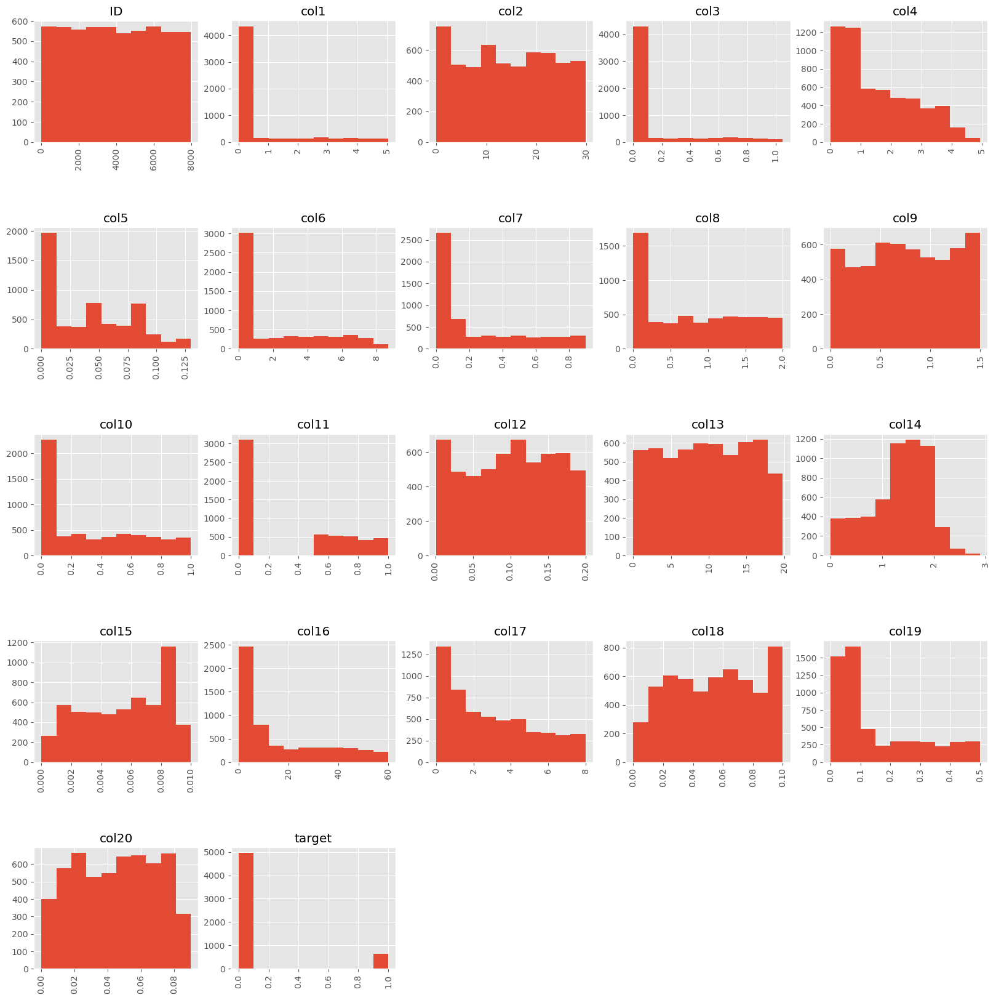

In [35]:
fig = plt.figure(figsize=(20, 20))
cols = 5
rows = int(np.ceil(float(df.shape[1]) / cols))
for i, column in enumerate(df.columns):
    ax = fig.add_subplot(rows, cols, i + 1)
    ax.set_title(column)
    if df.dtypes[column] == np.float64:
        df[column].hist(axes=ax)
        plt.xticks(rotation="vertical")
        
    else:
        df[column].hist(axes=ax)
        plt.xticks(rotation="vertical")
plt.subplots_adjust(hspace=0.7, wspace=0.2)

Analisis bivariante 

In [46]:
sns.pairplot(df,
            hue='target',
            height=4,
            vars=["col1", "col2", "col3","col4","col5","col6","col7","col8","col9","col10","col11","col12","col13","col14","col15","col16","col17","col18","col19","col20"],
            kind='reg'); # "reg" de regresión lineal

Matriz de correlacion para ver entre las variables la relación

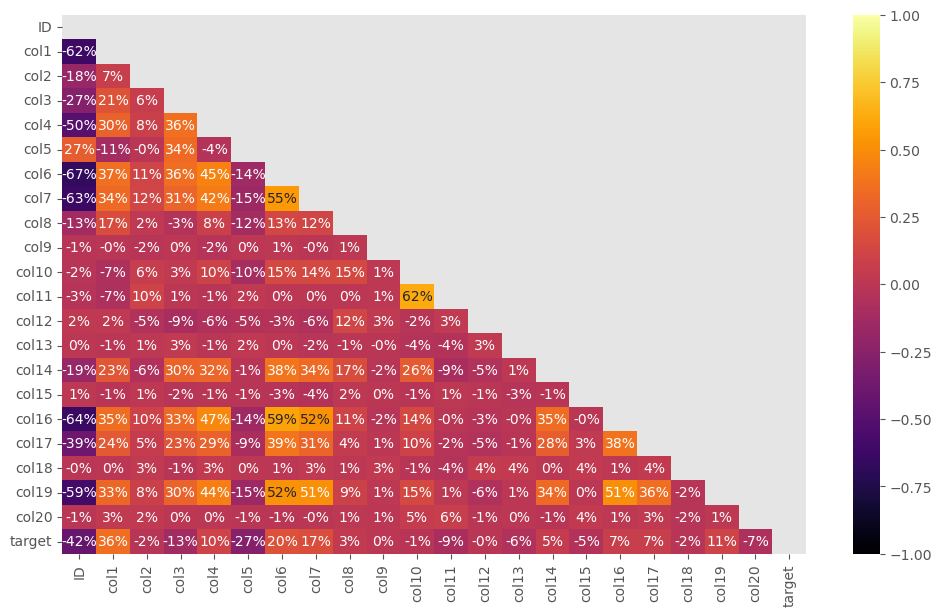

In [48]:
corr = df.corr()

# Definimos el tamaño de la figura
plt.subplots(figsize=(12, 7))

# Generamos una máscara para evitar tener un espejo en la parte superior de la gráfica y simplificar la observación
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True

ax = sns.heatmap(corr, annot=True, cmap='inferno', fmt=".0%", vmin=-1, vmax=1, center=0, mask=mask)

plt.show()

Correlaciones numericas

In [63]:

datos = df 

# Función para convertir una matriz de correlación de pandas en formato tidy
def tidy_corr_matrix(corr_mat):
    corr_mat = corr_mat.stack().reset_index()
    corr_mat.columns = ['col1', 'col2', 'r']
    corr_mat = corr_mat.loc[corr_mat['col1'] != corr_mat['col2'], :]
    corr_mat['abs_r'] = np.abs(corr_mat['r'])
    corr_mat = corr_mat.sort_values('abs_r', ascending=False)
    
    return corr_mat

corr_matrix = datos.select_dtypes(include=['float64', 'int64']) \
              .corr(method='pearson')
display(tidy_corr_matrix(corr_matrix).head(5))

,col1,col2,r,abs_r
132,col6,ID,-0.670282,0.670282
6,ID,col6,-0.670282,0.670282
16,ID,col16,-0.635645,0.635645
352,col16,ID,-0.635645,0.635645
154,col7,ID,-0.625041,0.625041


Normalizamos los datos, en este caso he elegido el MixMaxScaler primero. No sé si tendré tiempo de repetir el proceso con el estandar Scaler 

In [78]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Obtener los datos y el objetivo (target)
X = df.drop("target", axis=1)  # DataFrame con las características
y = df["target"]  # Serie con el objetivo

# Aplicar MinMaxScaler
minmax = MinMaxScaler()
X_minmax = minmax.fit_transform(X)

# Aplicar StandardScaler
#stdscaler = StandardScaler()
#X_std = stdscaler.fit_transform(X)

Modelizacion

### Train-test split

In [79]:
# División de los datos en train y test
# ==============================================================================
X = datos.drop(columns='target')
y = datos['target']

X_train, X_test, y_train, y_test = train_test_split(
                                        X,
                                        y.values.reshape(-1,1),
                                        train_size   = 0.7,
                                        random_state = 1234,
                                        shuffle      = True
                                    )

In [80]:
X_train.shape

(3917, 21)

In [81]:
X_test.shape

(1680, 21)

Entrenamiento del modelo:

Aplicamos el modelo de regresión logística porque el target es una variable categórica binaria en este caso . Para que no haya mas de una clase u otra , balanceamos con class_weight

In [76]:
from sklearn.linear_model import LogisticRegression

logisticRegr = LogisticRegression(max_iter=10000,class_weight='balanced')

logisticRegr.fit(X_train, y_train)

LogisticRegression(class_weight='balanced', max_iter=10000)

In [83]:
predictions = logisticRegr.predict(X_train)
print(predictions)

[0 0 0 ... 1 0 1]


Predicciones del modelo

In [90]:
logisticRegr.score(X_train, y_train)

0.8429920857799337

Probabilidades del modelo

In [89]:
predicions_proba = logisticRegr.predict_proba(X)
print(np.round(np.array(predicions_proba), 2))

[[0.93 0.07]
 [0.8  0.2 ]
 [0.96 0.04]
 ...
 [0.9  0.1 ]
 [0.81 0.19]
 [0.96 0.04]]


In [98]:
score = logisticRegr.score(X_test, y_test)
print('Acierta un ',round(score*100,2),'%', sep='')

Acierta un 85.0%


Otra opción, para disminuir la complejidad del modelo es disminuir el numero de caracteristicas del modelo, seleccionando las más importantes (en este caso 10)

In [87]:
from sklearn.feature_selection import SelectKBest, f_classif

# X son las características y y es la variable objetivo
selector = SelectKBest(score_func=f_classif, k=10)  # Selecciona las mejores 5 características
X_new = selector.fit_transform(X_train, y_train)  # Aplica la selección de características a X

# Obtén los índices de las características seleccionadas
feature_indices = selector.get_support(indices=True)
feature_indices

array([ 0,  1,  3,  4,  5,  6,  7, 11, 19, 20], dtype=int64)

# Adicional: Validación del Modelo

In [99]:
from sklearn.model_selection import KFold, cross_val_score


name = 'Logistic Regression'
kfold = KFold(n_splits=10)  # Parte los datos en 10 trozos para usar validación cruzada / cross validation
cv_results = cross_val_score(logisticRegr, X_train, y_train, cv=kfold, scoring='accuracy')

msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
print(cv_results)
print(msg)

[0.8494898  0.8494898  0.82142857 0.83418367 0.85459184 0.81632653
 0.83163265 0.84143223 0.83887468 0.84398977]
Logistic Regression: 0.838144 (0.011777)


In [101]:
model = LogisticRegression()
model.fit(X_train, y_train)

LogisticRegression()

In [104]:
predictions = model.predict(X_test)
print(accuracy_score(y_test, predictions))

0.919047619047619


In [105]:
acierto = accuracy_score(y_test, predictions)

error = 1 - acierto
print("Acierto:", round(acierto*100, 2), "%")
print("Error:", round(error*100, 2), "%")

Acierto: 91.9 %
Error: 8.1 %


Vemos el performance del modelo a través de la matriz

In [106]:
# Matriz de confusión

import sklearn.metrics as metrics

predictions = logisticRegr.predict(X_test)
cm = metrics.confusion_matrix(y_test, predictions)
cm
# Eje horizontal: falsos positivos
# Eje vertical: falsos negativos

array([[1263,  228],
       [  24,  165]], dtype=int64)

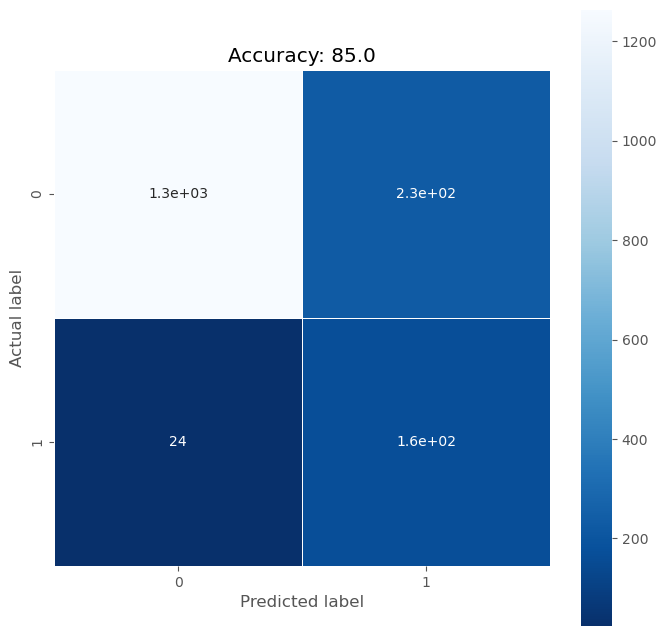

In [107]:
import seaborn as sns
plt.figure(figsize=(8,8))
sns.heatmap(cm, annot=True, linewidths=0.5,square=True,
           cmap='Blues_r')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
plt.title('Accuracy: '+str(round(score*100,2)));

Guardamos el modelo 

In [108]:
LogisticRegression

sklearn.linear_model._logistic.LogisticRegression

In [109]:
import pickle

with open('finished_model.model','wb') as file:
    pickle.dump(logisticRegr, file)

Modelo Random Forest 

Las características con mayor puntuación de importancia son las que están más correlacionadas con el objetivo en el modelo de Random Forest. Pero no sabemos la direccion

In [59]:
from sklearn.ensemble import RandomForestRegressor


# Variables independientes (X)
X = df[['col1', 'col2', 'col3', 'col4', 'col5', 'col6', 'col7', 'col8',
       'col9', 'col10', 'col11', 'col12', 'col13', 'col14', 'col15', 'col16',
       'col17', 'col18', 'col19', 'col20']]

# Variable dependiente (Y)
Y = df['target']

# Nombres de las características
names = ['col1', 'col2', 'col3', 'col4', 'col5', 'col6', 'col7', 'col8',
       'col9', 'col10', 'col11', 'col12', 'col13', 'col14', 'col15', 'col16',
       'col17', 'col18', 'col19', 'col20']

# Crear el modelo de regresión
rf = RandomForestRegressor(n_estimators=10)
rf.fit(X, Y)

# Obtener los puntajes de importancia de las características
scores = sorted(zip(map(lambda x: round(x, 4), rf.feature_importances_), names), reverse=True)

# Crear un DataFrame con los puntajes de importancia
df_scores = pd.DataFrame(scores, columns=['Score', 'Feature'])
df_scores

,Score,Feature
0,0.2109,col1
1,0.2046,col5
2,0.1659,col16
3,0.0637,col2
4,0.0446,col20
5,0.0409,col13
6,0.0403,col19
7,0.0350,col17
8,0.0271,col6
9,0.0239,col14
